In [1]:
import os
import sys
module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)

import numpy as np

import optuna 

import torch
from torch.utils.data import DataLoader
import torch.utils.data as data_utils
from torch.optim import SGD, Adam

import matplotlib.pyplot as plt
# plt.rcParams['figure.facecolor'] = 'white'

from datasets import get_dataset
from loss_fns import get_loss
from utils import solve

torch.set_default_dtype(torch.float64)


from dotenv import load_dotenv
load_dotenv()

/home/farshed.abdukhakimov/.conda/envs/sps2/lib/python3.10/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


True

In [2]:
def load_result(dataset, percent, scale, batch_size, epochs, loss_class, optimizer_class, lr, preconditioner, slack_method, lmd, mu, seed):
    
    results_dir = os.getenv("RESULTS_DIR")
    
    directory = f"{results_dir}/{dataset}/percent_{percent}/scale_{scale}/bs_{batch_size}" \
    f"/epochs_{epochs}/{loss_class}/{optimizer_class}/lr_{lr}/precond_{preconditioner}/slack_{slack_method}/lmd_{lmd}/mu_{mu}/seed_{seed}"

    grad_norm_sq = []
    loss = []
    slack = []

    grad_norm_sq = torch.load(f"{directory}/grad_norm_sq")
    loss = torch.load(f"{directory}/loss")

    if slack_method != "none" and optimizer_class != "bsps2":
        slack = torch.load(f"{directory}/slack")

    return {
        "loss": loss,
        "grad_norm_sq": grad_norm_sq,
        "slack": slack
    }


def get_optuna_lr(optimizer_name, dataset_name, batch_size, percentage, epochs, loss_name, scale):
    study_name = f"{optimizer_name}-{dataset_name}-{batch_size}-{percentage}-{epochs}-{loss_name}-{scale}"
    storage_name = "sqlite:///optuna_results/{}.db".format(study_name)
    study = optuna.load_study(study_name=study_name, storage=storage_name)
    lr = study.best_params["lr"]
    return lr

In [13]:
def moving_average(list_, n=30):
    mov = []
    for i in range(len(list_)):
        mov.append(mov_av(list_[i],n))
    return mov

def mov_av(list_,n):
    tensor = torch.tensor(list_)
    mov = []
    for i, t in enumerate(tensor):
        if i < n:
            mov.append(torch.mean(tensor[:i+1]).item())
        else:
            mov.append(torch.mean(tensor[i-n+1:i+1]).item())
    return mov


def get_results(optimizer, dataset, percent, scale, 
                bs, epochs, loss, lr, 
                precond, slack_method, lmd, mu):
                        
    results_dir = os.getenv("RESULTS_DIR")
    directory = f"{results_dir}/{dataset}/percent_{percent}/scale_{scale}/bs_{bs}/epochs_{epochs}/{loss}/{optimizer}/lr_{lr}/precond_{precond}/slack_{slack_method}/lmd_{lmd}/mu_{mu}"

    grad_norm_sq = []
    loss = []
    slack = []

    for seed in range(5):
        grad_norm_sq.append(torch.load(f"{directory}/seed_{seed}/grad_norm_sq"))
        loss.append(torch.load(f"{directory}/seed_{seed}/loss"))
        if slack_method != "none":
            slack.append(torch.load(f"{directory}/seed_{seed}/slack"))
        else:
            slack.append(torch.zeros_like(torch.asarray(loss[-1])))
    
    return {
        "loss": loss,
        "grad_norm_sq": grad_norm_sq,
        "slack": slack
    }



def get_label(method, precond, slack):

    if slack == "none":
        slack = ""
    
    if method == "psps":
        if precond == "hutch":
            return f"PSPS{slack}"
        return f"SPS{slack}"
        
    elif method == "sp2plus":
        return f"SP2+{slack}"
    
    elif method == "psps2":
        res = f"PSPS2{slack} "
        if precond == "DD":
            res += "Hutchinson"
        elif precond == "BB":
            res += "SR-1"
        elif precond == "DB":
            res += "Hutchinson + SR-1"
        return res

colors = {
    "sgd": "blue",
    "adam": "green",
    "adagrad": "maroon",
    "adadelta": "darkolivegreen",
    "rmsprop": "teal",
    "adahessian": "dodgerblue",
    
    "psps_none_none": "indigo",
    "psps_hutch_none": "darkorange",
    "psps_none_L1": "red",
    "psps_none_L2": "cyan",
    "psps_hutch_L1": "black",
    "psps_hutch_L2": "magenta",

    "psps2_DD_none": "limegreen" ,
    "psps2_DD_L1": "midnightblue",
    "psps2_DD_L2": "aquamarine",

    "psps2_BB_none": "crimson",
    "psps2_BB_L1": "olivedrab",
    "psps2_BB_L2": "cadetblue",

    "psps2_DB_none": "slategray",
    "psps2_DB_L1": "indianred",
    "psps2_DB_L2": "plum",

    "sp2plus_none_none": "lightseagreen",
    "sp2plus_none_L1": "hotpink",
    "sp2plus_none_L2": "saddlebrown",
}


linestyles = ['-', '--', '-.', ':', '-', '--', '-.', ':']
markers = ("o", "8", "D", "*", "p", "P")

settings = {
    "a1a": [500, 1.0, 64, [0.0005, 0.005, 0.05]],
    "a9a": [500, 1.0, 2048, [0.0001, 0.001, 0.01]],
    "mushrooms": [500, 1.0,  64, [0.0005, 0.005, 0.05]],
    "colon-cancer": [500, 1.0, 8, [0.0005, 0.005, 0.05]],
    "synthetic-1000x100-modified": [1000, 1.0, 128, [0.0001, 0.001, 0.01]],
}

default_lr = 0.1
lmd = 0.01
mu = 0.1

psps2_L2-a1a-opt-sgd-scale_0-bs_64-epochs_500-loss_logreg-lrs[0.0005, 0.005, 0.05]-lmd_0.01-mu_0.1
psps2_L2-a1a-opt-adam-scale_0-bs_64-epochs_500-loss_logreg-lrs[0.0005, 0.005, 0.05]-lmd_0.01-mu_0.1
psps2_L2-a1a-opt-sgd-scale_5-bs_64-epochs_500-loss_logreg-lrs[0.0005, 0.005, 0.05]-lmd_0.01-mu_0.1
psps2_L2-a1a-opt-adam-scale_5-bs_64-epochs_500-loss_logreg-lrs[0.0005, 0.005, 0.05]-lmd_0.01-mu_0.1


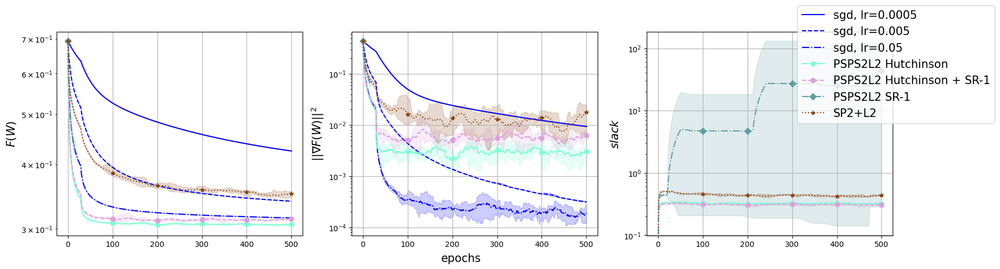

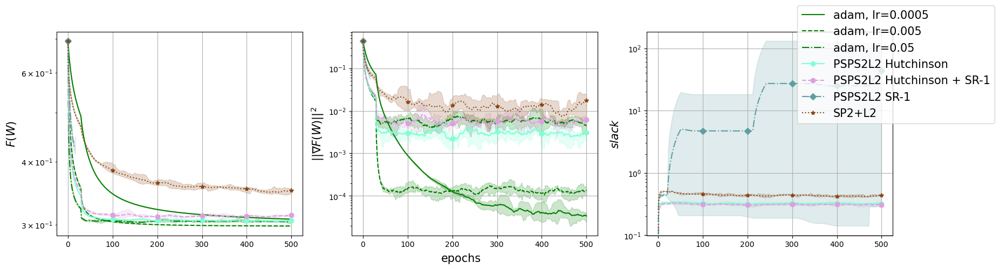

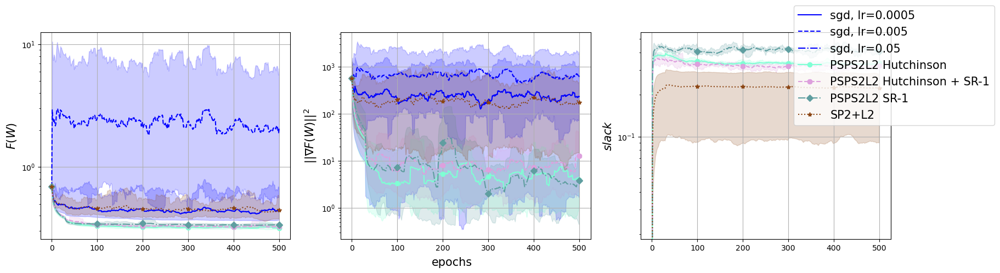

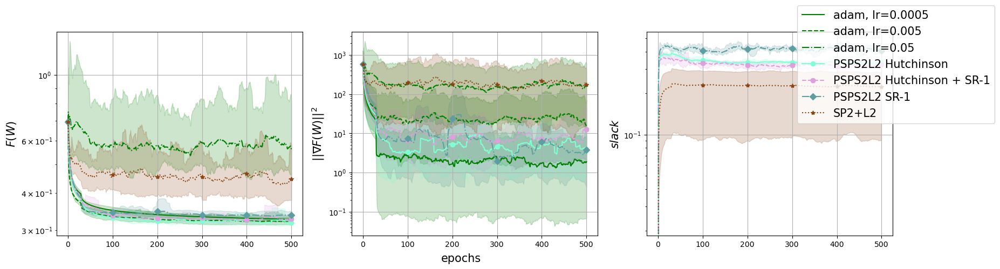

In [18]:
losses = [
    # "mse",
    # "nllsq",
    "logreg"
]

datasets = [
    # "synthetic-1000x100-modified",
    "a1a"
]

# ps_methods, plot_slack, slack_title = ("psps_none_none",  "psps_hutch_none", "psps2_DD_none", "psps2_BB_none", "psps2_DB_none", "sp2plus_none_none"), False, ""

# ps_methods, plot_slack, slack_title = ("psps_none_none",  "psps_hutch_none", "sp2plus_none_none"), False, ""
# ps_methods, plot_slack, slack_title = ("psps2_DD_none",  "psps2_BB_none", "psps2_DB_none", "sp2plus_none_none"), False, ""
# ps_methods, plot_slack, slack_title = ("psps_none_none",  "psps_hutch_none", "psps2_DD_none",  "psps2_BB_none", "psps2_DB_none"), False, ""

# ps_methods, plot_slack, slack_title = ("psps_none_L1",  "psps_hutch_L1", "psps2_DD_L1", "psps2_BB_L1", "psps2_DB_L1", "sp2plus_none_L1"), True, "_L1"
# ps_methods, plot_slack, slack_title = ("psps_none_L1",  "psps_hutch_L1", "sp2plus_none_L1"), True, "_L1"
# ps_methods, plot_slack, slack_title = ("psps_none_L2",  "psps_hutch_L2", "sp2plus_none_L2"), True, "_L2"

ps_methods, plot_slack, slack_title = ("psps_hutch_L2", "psps2_DD_L2", "psps2_BB_L2", "psps2_DB_L2", "sp2plus_none_L2"), True, "_L2"

# ps_methods, plot_slack, slack_title = ("psps2_DD_L1", "psps2_DB_L1", "sp2plus_none_L1"), True, "_L1"
# ps_methods, plot_slack, slack_title = ("psps2_DD_L2", "psps2_DB_L2", "psps2_BB_L2", "sp2plus_none_L2"), True, "_L2"



# ps_methods, plot_slack, slack_title = ("psps_none_L2",  "psps_hutch_L2", "psps2_DD_L2", "psps2_BB_L2", "psps2_DB_L2", "sp2plus_none_L2"), True, "_L2"

for scale in (0, 5):

    # for method in ["sgd", "adam", "adagrad", "adadelta", "rmsprop", "adahessian"]:
    for method in ["adam"]:

        for dataset in datasets:    

            epochs, percent, bs, lrs = settings[dataset]

            for loss in losses:

                fontsize = 15
                if plot_slack:
                    fig, ax = plt.subplots(1, 3, figsize=(20, 5), dpi=100)
                else:
                    fig, ax = plt.subplots(1, 2, figsize=(16, 5), dpi=100)



                # non ps methods
                for ls, lr in zip(linestyles, lrs):
                    label = f"{method}, lr={lr}"
                        
                    res = get_results(method, dataset, percent, scale, bs, epochs, loss, lr, "none", "none", lmd, mu)
                    # loss
                    mean_line = np.mean(moving_average(res["loss"]), axis=0)
                    max_line = np.max(moving_average(res["loss"]), axis=0)
                    min_line = np.min(moving_average(res["loss"]), axis=0)
                    x = np.linspace(0, mean_line.shape[0] - 1, mean_line.shape[0])
                    ax[0].fill_between(x, max_line, min_line, alpha=0.2, color=colors[method])
                    ax[0].semilogy(x, mean_line, color=colors[method], linestyle=ls ,label=label)
                    ax[0].set_ylabel(r"$ F(W) $", fontsize=fontsize)

                    # grad_norm_sq
                    mean_line = np.mean(moving_average(res["grad_norm_sq"]), axis=0)
                    max_line = np.max(moving_average(res["grad_norm_sq"]), axis=0)
                    min_line = np.min(moving_average(res["grad_norm_sq"]), axis=0)
                    x = np.linspace(0, mean_line.shape[0] - 1, mean_line.shape[0])
                    ax[1].fill_between(x, max_line, min_line, alpha=0.2, color=colors[method])
                    ax[1].semilogy(x, mean_line, linestyle=ls, color=colors[method])
                    ax[1].set_ylabel(r"$\|\| \nabla F(W) \|\|^2$", fontsize=fontsize)



                # get_results(optimizer, dataset, percent, scale, bs, epochs, loss, lr, precond, slack_method, lmd, mu)

                # PS methods
                for ps_method, marker, linestyle in zip(ps_methods, markers, linestyles):
                    ps_method_name, precond, slack = ps_method.split("_")

                    label = get_label(ps_method_name, precond, slack)
                    
                    if ps_method_name == "psps":
                        res = get_results(ps_method_name, dataset, percent, scale, bs, epochs, loss, default_lr, precond, slack, lmd, mu)
                    elif ps_method_name == "psps2":
                        res = get_results(f"{ps_method_name}_{precond}", dataset, percent, scale, bs, epochs, loss, default_lr, "none", slack, lmd, mu)
                    elif ps_method_name == "sp2plus":
                        res = get_results(f"{ps_method_name}", dataset, percent, scale, bs, epochs, loss, default_lr, "none", slack, lmd, mu)
                    
                    # loss 
                    mean_line = np.mean(moving_average(res["loss"]), axis=0)
                    max_line = np.max(moving_average(res["loss"]), axis=0)
                    min_line = np.min(moving_average(res["loss"]), axis=0)
                    x = np.linspace(0, mean_line.shape[0] - 1, mean_line.shape[0])
                    markevery = [x for x in range(0, mean_line.shape[0], 100)]

                    ax[0].fill_between(x, max_line, min_line, alpha=0.2, color=colors[f"{ps_method}"]) 
                    ax[0].semilogy(x, mean_line, color=colors[f"{ps_method}"], linestyle=linestyle, label=label, marker=marker, markevery=markevery)
                    ax[0].grid(True)

                    # grad_norm_sq
                    mean_line = np.mean(moving_average(res["grad_norm_sq"]), axis=0)
                    max_line = np.max(moving_average(res["grad_norm_sq"]), axis=0)
                    min_line = np.min(moving_average(res["grad_norm_sq"]), axis=0)

                    x = np.linspace(0, mean_line.shape[0] - 1, mean_line.shape[0])
                    markevery = [x for x in range(0, mean_line.shape[0], 100)]

                    ax[1].fill_between(x, max_line, min_line, alpha=0.2, color=colors[f"{ps_method}"]) 
                    ax[1].semilogy(x, mean_line, color=colors[f"{ps_method}"], linestyle=linestyle, marker=marker, markevery=markevery)
                    ax[1].grid(True)

                    # slack
                    if plot_slack:
                        mean_line = np.mean(moving_average(res["slack"]), axis=0)
                        max_line = np.max(moving_average(res["slack"]), axis=0)
                        min_line = np.min(moving_average(res["slack"]), axis=0)

                        x = np.linspace(0, mean_line.shape[0] - 1, mean_line.shape[0])
                        markevery = [x for x in range(0, mean_line.shape[0], 100)]

                        ax[2].fill_between(x, max_line, min_line, alpha=0.2, color=colors[f"{ps_method}"]) 
                        ax[2].semilogy(x, mean_line, color=colors[f"{ps_method}"], linestyle=linestyle, marker=marker, markevery=markevery)
                        ax[2].set_ylabel(r"$slack$", fontsize=fontsize)
                        ax[2].grid(True)


                title = f"psps3{slack_title}-{dataset}-opt-{method}-scale_{scale}-bs_{bs}-epochs_{epochs}-loss_{loss}-lrs{lrs}-lmd_{lmd}-mu_{mu}"
                print(title)
                # fig.suptitle(title)
                # fig.legend(["adam", "sgd", "sps_l1", "sps_l2", "sps_l1_d", "sps_l2_d"])
                fig.legend(prop={"size": fontsize})
                fig.text(0.5, 0.04, 'epochs', ha='center', va='center', fontsize=fontsize)
                # fig.tight_layout()

                # ax[0].set_ylim(top=5.25e-1)
                # ax[1].set_ylim(bottom=1e-14, top=1e5)
                    
                fig.savefig(f"presentation_plots/{title}.pdf", dpi=200, format="pdf", transparent=False)

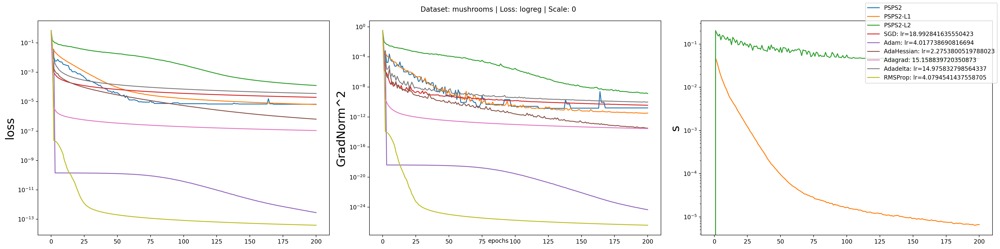

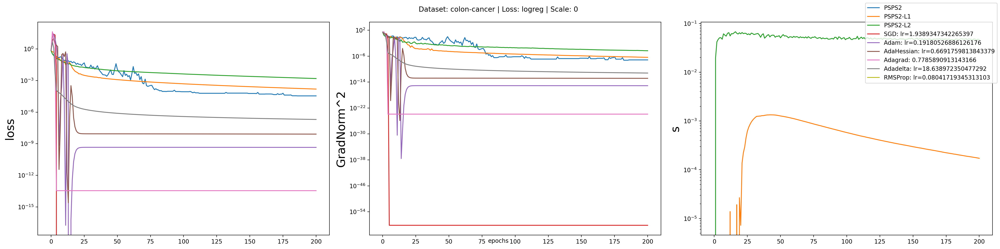

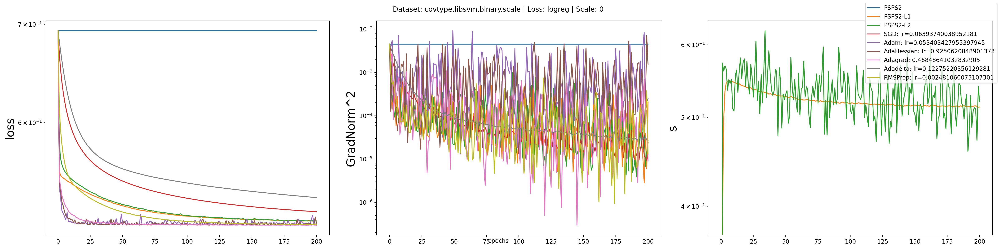

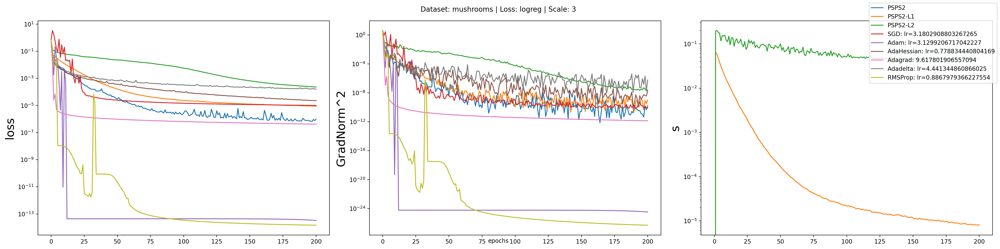

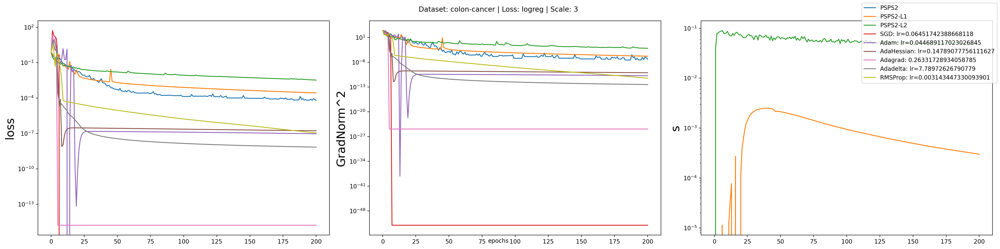

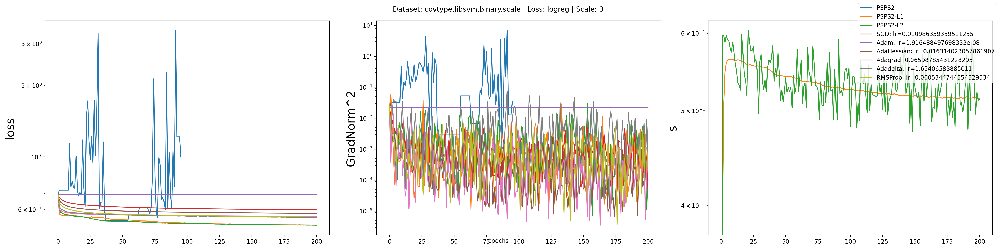

In [14]:
optimizers = ["sgd", "sps2", "bsps2", "adam", "adahessian", "adadelta", "adagrad", "rmsprop"]

datasets_setup = [
    ["mushrooms", 64, 1.0],
    ["colon-cancer", 8, 1.0],
    ["covtype.libsvm.binary.scale", 512, 0.1]
    ]

loss_class = "logreg"
EPOCHS = 200
lmd = 0.01
mu = 0.1
default_lr = 0.1

scales = [0, 3]
for scale in scales:
    for dataset_name, batch_size, percentage in datasets_setup:
        
        lr_sgd = get_optuna_lr(optimizer_name="sgd", dataset_name=dataset_name, batch_size=batch_size, percentage=percentage,
                            epochs=300, loss_name=loss_class, scale=scale)
        hist_sgd = load_result(dataset=dataset_name, percent=percentage, scale=scale, batch_size=batch_size, 
        epochs=EPOCHS, loss_class=loss_class, optimizer_class="sgd", lr=round(lr_sgd, 3), preconditioner="none", slack_method="none", lmd=lmd, mu=mu, seed=0)

        lr_adam = get_optuna_lr(optimizer_name="adam", dataset_name=dataset_name, batch_size=batch_size, percentage=percentage,
                            epochs=300, loss_name=loss_class, scale=scale)
        hist_adam = load_result(dataset=dataset_name, percent=percentage, scale=scale, batch_size=batch_size, 
        epochs=EPOCHS, loss_class=loss_class, optimizer_class="adam", lr=round(lr_adam, 3), preconditioner="none", slack_method="none", lmd=lmd, mu=mu, seed=0)

        lr_adahessian = get_optuna_lr(optimizer_name="adahessian", dataset_name=dataset_name, batch_size=batch_size, percentage=percentage,
                            epochs=300, loss_name=loss_class, scale=scale)
        hist_adahessian = load_result(dataset=dataset_name, percent=percentage, scale=scale, batch_size=batch_size, 
        epochs=EPOCHS, loss_class=loss_class, optimizer_class="adahessian", lr=round(lr_adahessian, 3), preconditioner="none", slack_method="none", lmd=lmd, mu=mu, seed=0)

        lr_adagrad = get_optuna_lr(optimizer_name="adagrad", dataset_name=dataset_name, batch_size=batch_size, percentage=percentage,
                            epochs=300, loss_name=loss_class, scale=scale)
        hist_adagrad = load_result(dataset=dataset_name, percent=percentage, scale=scale, batch_size=batch_size, 
        epochs=EPOCHS, loss_class=loss_class, optimizer_class="adagrad", lr=round(lr_adagrad, 3), preconditioner="none", slack_method="none", lmd=lmd, mu=mu, seed=0)

        lr_adadelta = get_optuna_lr(optimizer_name="adadelta", dataset_name=dataset_name, batch_size=batch_size, percentage=percentage,
                            epochs=300, loss_name=loss_class, scale=scale)
        hist_adadelta = load_result(dataset=dataset_name, percent=percentage, scale=scale, batch_size=batch_size, 
        epochs=EPOCHS, loss_class=loss_class, optimizer_class="adadelta", lr=round(lr_adadelta, 3), preconditioner="none", slack_method="none", lmd=lmd, mu=mu, seed=0)

        lr_rmsprop = get_optuna_lr(optimizer_name="rmsprop", dataset_name=dataset_name, batch_size=batch_size, percentage=percentage,
                            epochs=300, loss_name=loss_class, scale=scale)
        hist_rmsprop = load_result(dataset=dataset_name, percent=percentage, scale=scale, batch_size=batch_size, 
        epochs=EPOCHS, loss_class=loss_class, optimizer_class="rmsprop", lr=round(lr_rmsprop, 3), preconditioner="none", slack_method="none", lmd=lmd, mu=mu, seed=0)


        hist_sps2 = load_result(dataset=dataset_name, percent=percentage, scale=scale, batch_size=batch_size, 
        epochs=EPOCHS, loss_class=loss_class, optimizer_class="sps2", lr=default_lr, preconditioner="hutch", slack_method="none", lmd=lmd, mu=mu, seed=0)

        hist_sps2_l1 = load_result(dataset=dataset_name, percent=percentage, scale=scale, batch_size=batch_size, 
        epochs=EPOCHS, loss_class=loss_class, optimizer_class="sps2", lr=default_lr, preconditioner="hutch", slack_method="L1", lmd=lmd, mu=mu, seed=0)

        hist_sps2_l2 = load_result(dataset=dataset_name, percent=percentage, scale=scale, batch_size=batch_size, 
        epochs=EPOCHS, loss_class=loss_class, optimizer_class="sps2", lr=default_lr, preconditioner="hutch", slack_method="L2", lmd=lmd, mu=mu, seed=0)


        fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 6), dpi=200)

        ax1.semilogy(hist_sps2["loss"])
        ax1.semilogy(hist_sps2_l1["loss"])
        ax1.semilogy(hist_sps2_l2["loss"])
        ax1.semilogy(hist_sgd["loss"])
        ax1.semilogy(hist_adam["loss"])
        ax1.semilogy(hist_adahessian["loss"])
        ax1.semilogy(hist_adagrad["loss"])
        ax1.semilogy(hist_adadelta["loss"])
        ax1.semilogy(hist_rmsprop["loss"])

        ax2.semilogy(hist_sps2["grad_norm_sq"])
        ax2.semilogy(hist_sps2_l1["grad_norm_sq"])
        ax2.semilogy(hist_sps2_l2["grad_norm_sq"])
        ax2.semilogy(hist_sgd["grad_norm_sq"])
        ax2.semilogy(hist_adam["grad_norm_sq"])
        ax2.semilogy(hist_adahessian["grad_norm_sq"])
        ax2.semilogy(hist_adagrad["grad_norm_sq"])
        ax2.semilogy(hist_adadelta["grad_norm_sq"])
        ax2.semilogy(hist_rmsprop["grad_norm_sq"])

        ax3.semilogy([0 for x in hist_sps2["loss"]])
        ax3.semilogy([x for x in hist_sps2_l1["slack"]])
        ax3.semilogy([x for x in hist_sps2_l2["slack"]])
        ax3.semilogy([0 for x in hist_sgd["loss"]])
        ax3.semilogy([0 for x in hist_adam["loss"]])
        ax3.semilogy([0 for x in hist_adahessian["loss"]])
        ax3.semilogy([0 for x in hist_adagrad["loss"]])
        ax3.semilogy([0 for x in hist_adadelta["loss"]])
        ax3.semilogy([0 for x in hist_rmsprop["loss"]])

        ax1.set_ylabel('loss', fontsize=20)
        ax2.set_ylabel('GradNorm^2', fontsize=20)
        ax3.set_ylabel('s', fontsize=20)

        fig.text(0.5, 0.04, 'epochs', ha='center', va='center', )
        fig.suptitle(f"Dataset: {dataset_name} | Loss: {loss_class} | Scale: {scale}")
        fig.legend(['PSPS2', 'PSPS2-L1', 'PSPS2-L2', f'SGD: lr={lr_sgd}', f'Adam: lr={lr_adam}', f"AdaHessian: lr={lr_adahessian}", f"Adagrad: {lr_adagrad}",
            f"Adadelta: lr={lr_adadelta}", f"RMSProp: lr={lr_rmsprop}"])
        plt.tight_layout()
        fig.show()

        # plots_dir = os.getenv("PLOTS_DIR")
        # fig.savefig(f"{plots_dir}/{dataset_name}-scale_{scale}-bs_{batch_size}-epochs_{EPOCHS}-loss_{loss_class}-lmd_{lmd}-mu_{mu}.png")




In [19]:
optimizers = ["sgd", "sps2", "bsps2", "adam", "adahessian", "adadelta", "adagrad", "rmsprop"]

datasets_setup = [
    ["mushrooms", 64, 1.0],
    ["colon-cancer", 8, 1.0],
    ["covtype.libsvm.binary.scale", 512, 0.1]
    ]

def plot_vs_other(psps_optimizer_name, other_optimizer_name, loss_class, lrs, scales):

    EPOCHS = 200
    lmd = 0.01
    mu = 0.1
    default_lr = 0.1
    
    for scale in scales:
        for dataset_name, batch_size, percentage in datasets_setup:

            hist_list = []
            for lr in lrs:
                hist = load_result(dataset=dataset_name, percent=percentage, scale=scale, batch_size=batch_size, 
                epochs=EPOCHS, loss_class=loss_class, optimizer_class=other_optimizer_name, lr=lr, preconditioner="none", slack_method="none", lmd=lmd, mu=mu, seed=0)
                hist_list.append(hist)
            
            hist_sps2 = load_result(dataset=dataset_name, percent=percentage, scale=scale, batch_size=batch_size, 
            epochs=EPOCHS, loss_class=loss_class, optimizer_class=psps_optimizer_name, lr=default_lr, preconditioner="hutch", slack_method="none", lmd=lmd, mu=mu, seed=0)

            hist_sps2_l1 = load_result(dataset=dataset_name, percent=percentage, scale=scale, batch_size=batch_size, 
            epochs=EPOCHS, loss_class=loss_class, optimizer_class=psps_optimizer_name, lr=default_lr, preconditioner="hutch", slack_method="L1", lmd=lmd, mu=mu, seed=0)

            hist_sps2_l2 = load_result(dataset=dataset_name, percent=percentage, scale=scale, batch_size=batch_size, 
            epochs=EPOCHS, loss_class=loss_class, optimizer_class=psps_optimizer_name, lr=default_lr, preconditioner="hutch", slack_method="L2", lmd=lmd, mu=mu, seed=0)


            fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 6), dpi=200)

            ax1.semilogy(hist_sps2["loss"])
            ax1.semilogy(hist_sps2_l1["loss"])
            ax1.semilogy(hist_sps2_l2["loss"])
            for hist_sgd, ls in zip(hist_list, linestyles):
                ax1.semilogy(hist_sgd["loss"], color="indigo", linestyle=ls)

            ax2.semilogy(hist_sps2["grad_norm_sq"])
            ax2.semilogy(hist_sps2_l1["grad_norm_sq"])
            ax2.semilogy(hist_sps2_l2["grad_norm_sq"])
            for hist, ls in zip(hist_list, linestyles):
                ax2.semilogy(hist["grad_norm_sq"], color="indigo", linestyle=ls)

            ax3.semilogy([0 for x in hist_sps2["loss"]])
            ax3.semilogy([x for x in hist_sps2_l1["slack"]])
            ax3.semilogy([x for x in hist_sps2_l2["slack"]])
            for hist, ls in zip(hist_list, linestyles):
                try:
                    ax3.semilogy([x for x in hist["slack"]], color="indigo", linestyle=ls)
                except Exception:
                    ax3.semilogy([0 for x in hist["slack"]], color="indigo", linestyle=ls)

            ax1.set_ylabel('loss', fontsize=20)
            ax2.set_ylabel('GradNorm^2', fontsize=20)
            ax3.set_ylabel('s', fontsize=20)

            fig.text(0.5, 0.04, 'epochs', ha='center', va='center', )
            fig.suptitle(f"Dataset: {dataset_name} | Loss: {loss_class} | Scale: {scale}")
            legend_text = [f'{psps_optimizer_name.upper()}', f'{psps_optimizer_name.upper()}-L1', f'{psps_optimizer_name.upper()}-L2']
            for lr in lrs:
                legend_text.append(f'{other_optimizer_name.upper()}: lr={lr}')
            fig.legend(legend_text)
            plt.tight_layout()
            fig.show()

            # plots_dir = os.getenv("PLOTS_DIR")
            # fig.savefig(f"{plots_dir}/{dataset_name}-scale_{scale}-bs_{batch_size}-epochs_{EPOCHS}-loss_{loss_class}-lmd_{lmd}-mu_{mu}.png")




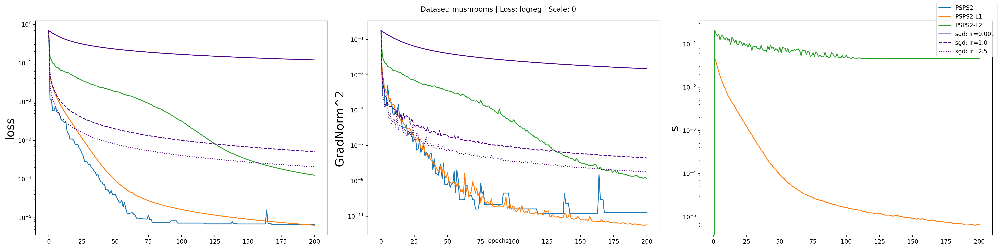

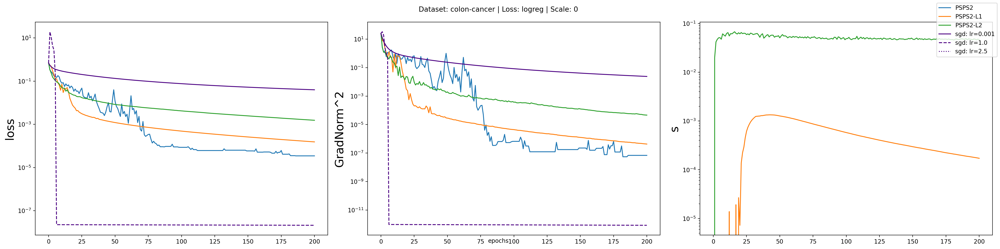

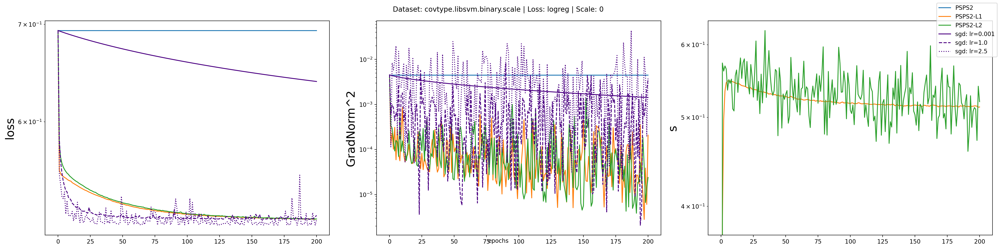

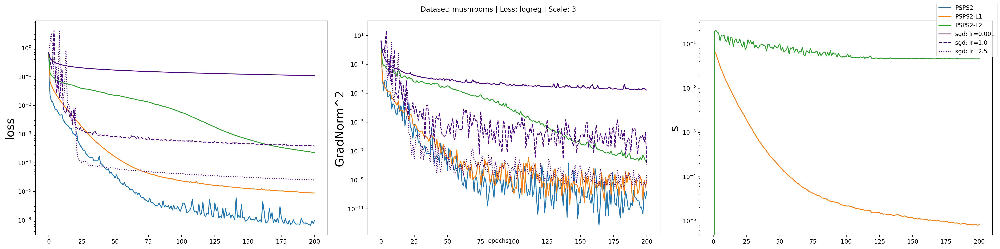

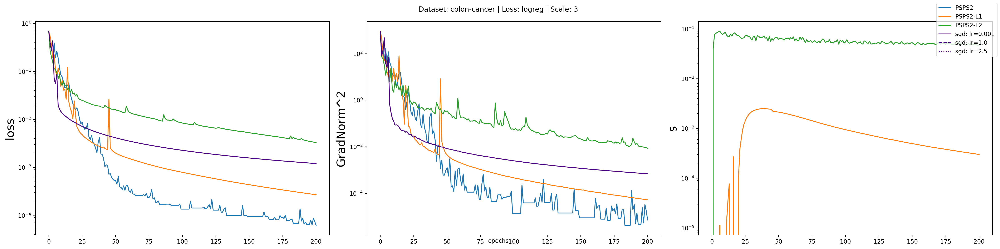

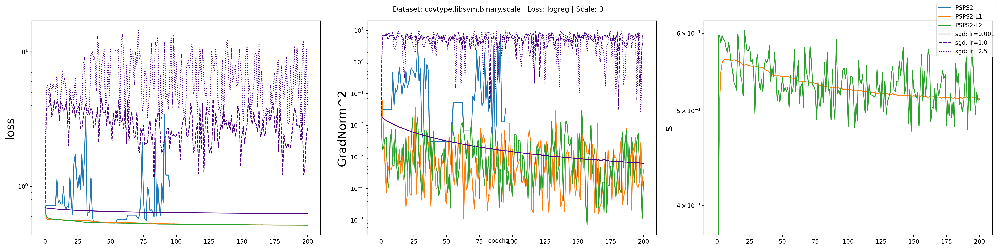

In [20]:
plot_vs_other("sps2", "sgd", "logreg", [0.001, 1.0, 2.5], [0, 3])

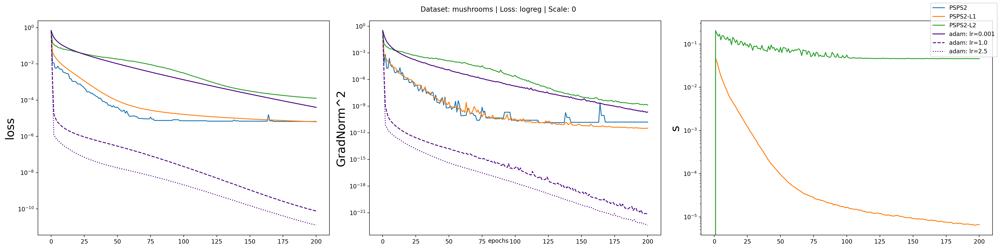

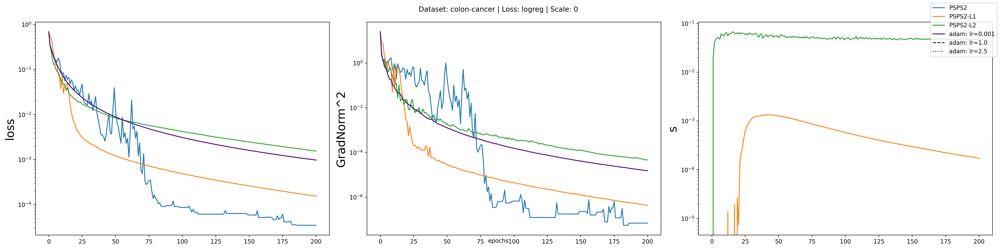

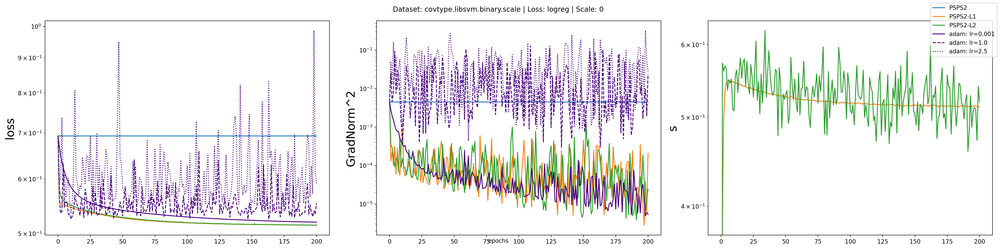

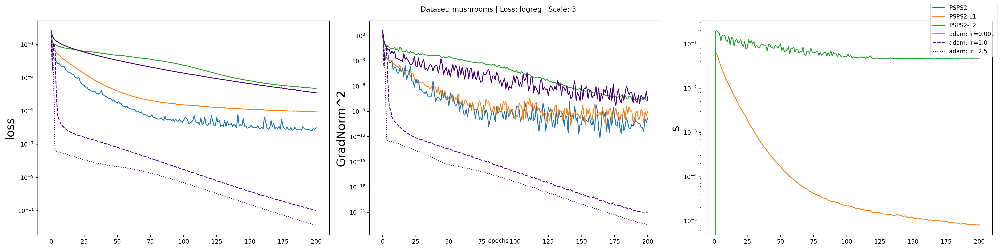

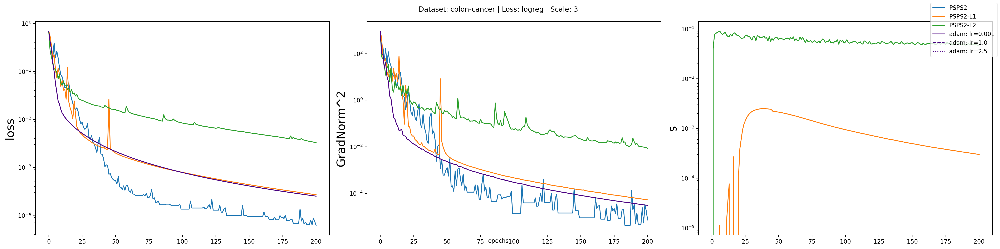

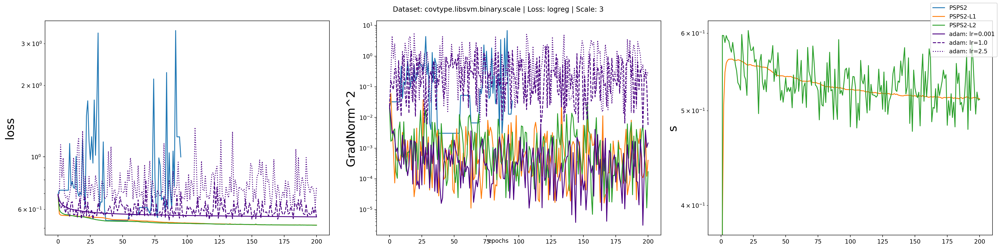

In [21]:
plot_vs_other("sps2", "adam", "logreg", [0.001, 1.0, 2.5], [0, 3])

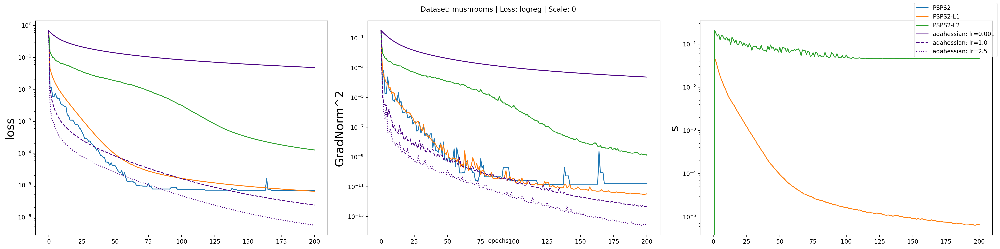

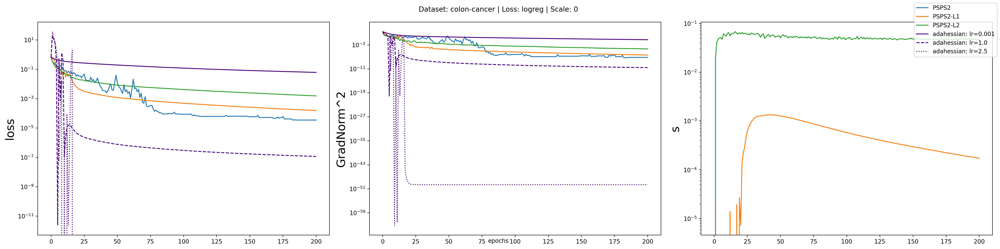

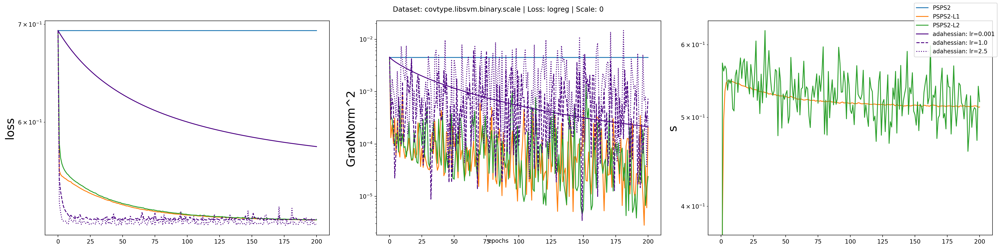

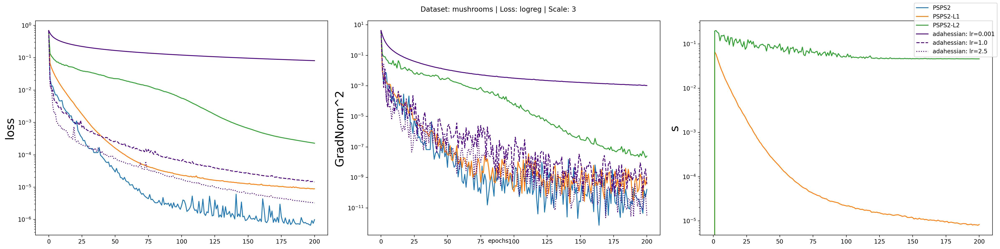

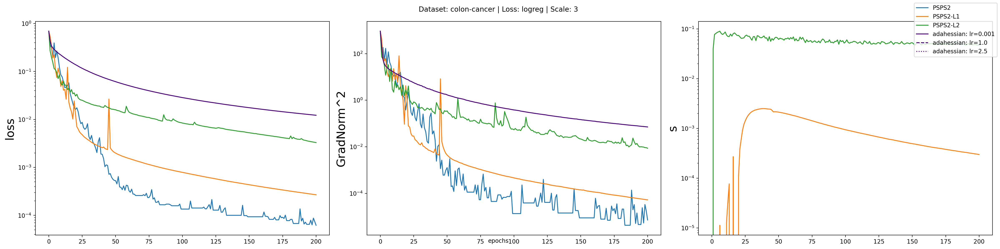

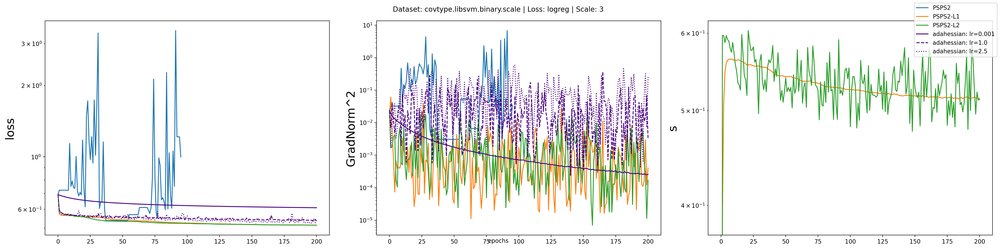

In [22]:
plot_vs_other("sps2", "adahessian", "logreg", [0.001, 1.0, 2.5], [0, 3])

In [ ]:
plot_vs_other("bsps2", "sgd", "logreg", [0.001, 1.0, 2.5], [0])

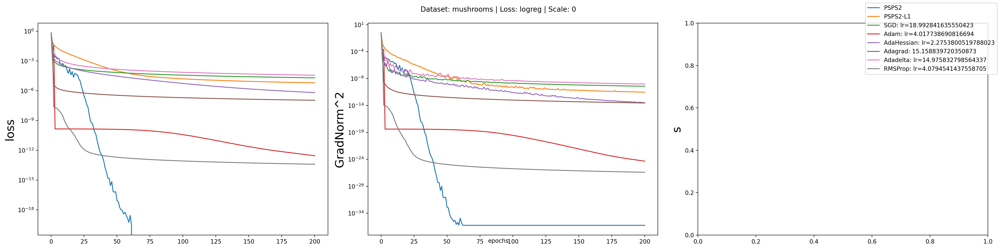

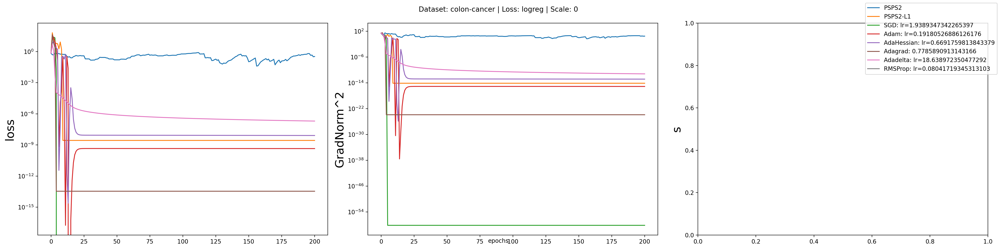

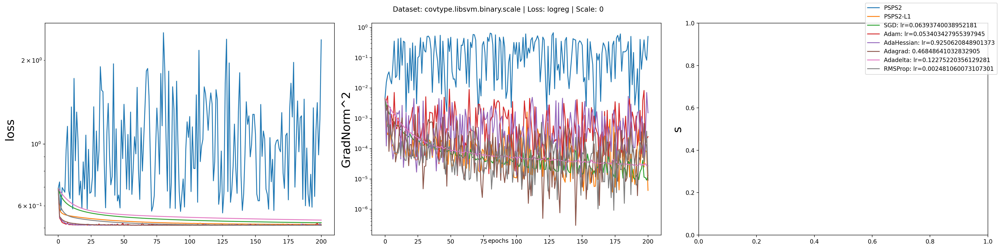

In [35]:
optimizers = ["sgd", "sps2", "bsps2", "adam", "adahessian", "adadelta", "adagrad", "rmsprop"]

datasets_setup = [
    ["mushrooms", 64, 1.0],
    ["colon-cancer", 8, 1.0],
    ["covtype.libsvm.binary.scale", 512, 0.1]
    ]

loss_class = "logreg"
EPOCHS = 200
lmd = 0.01
mu = 0.1
default_lr = 0.1

scales = [0]
for scale in scales:
    for dataset_name, batch_size, percentage in datasets_setup:
        
        lr_sgd = get_optuna_lr(optimizer_name="sgd", dataset_name=dataset_name, batch_size=batch_size, percentage=percentage,
                            epochs=300, loss_name=loss_class, scale=scale)
        hist_sgd = load_result(dataset=dataset_name, percent=percentage, scale=scale, batch_size=batch_size, 
        epochs=EPOCHS, loss_class=loss_class, optimizer_class="sgd", lr=round(lr_sgd, 3), preconditioner="none", slack_method="none", lmd=lmd, mu=mu, seed=0)

        lr_adam = get_optuna_lr(optimizer_name="adam", dataset_name=dataset_name, batch_size=batch_size, percentage=percentage,
                            epochs=300, loss_name=loss_class, scale=scale)
        hist_adam = load_result(dataset=dataset_name, percent=percentage, scale=scale, batch_size=batch_size, 
        epochs=EPOCHS, loss_class=loss_class, optimizer_class="adam", lr=round(lr_adam, 3), preconditioner="none", slack_method="none", lmd=lmd, mu=mu, seed=0)

        lr_adahessian = get_optuna_lr(optimizer_name="adahessian", dataset_name=dataset_name, batch_size=batch_size, percentage=percentage,
                            epochs=300, loss_name=loss_class, scale=scale)
        hist_adahessian = load_result(dataset=dataset_name, percent=percentage, scale=scale, batch_size=batch_size, 
        epochs=EPOCHS, loss_class=loss_class, optimizer_class="adahessian", lr=round(lr_adahessian, 3), preconditioner="none", slack_method="none", lmd=lmd, mu=mu, seed=0)

        lr_adagrad = get_optuna_lr(optimizer_name="adagrad", dataset_name=dataset_name, batch_size=batch_size, percentage=percentage,
                            epochs=300, loss_name=loss_class, scale=scale)
        hist_adagrad = load_result(dataset=dataset_name, percent=percentage, scale=scale, batch_size=batch_size, 
        epochs=EPOCHS, loss_class=loss_class, optimizer_class="adagrad", lr=round(lr_adagrad, 3), preconditioner="none", slack_method="none", lmd=lmd, mu=mu, seed=0)

        lr_adadelta = get_optuna_lr(optimizer_name="adadelta", dataset_name=dataset_name, batch_size=batch_size, percentage=percentage,
                            epochs=300, loss_name=loss_class, scale=scale)
        hist_adadelta = load_result(dataset=dataset_name, percent=percentage, scale=scale, batch_size=batch_size, 
        epochs=EPOCHS, loss_class=loss_class, optimizer_class="adadelta", lr=round(lr_adadelta, 3), preconditioner="none", slack_method="none", lmd=lmd, mu=mu, seed=0)

        lr_rmsprop = get_optuna_lr(optimizer_name="rmsprop", dataset_name=dataset_name, batch_size=batch_size, percentage=percentage,
                            epochs=300, loss_name=loss_class, scale=scale)
        hist_rmsprop = load_result(dataset=dataset_name, percent=percentage, scale=scale, batch_size=batch_size, 
        epochs=EPOCHS, loss_class=loss_class, optimizer_class="rmsprop", lr=round(lr_rmsprop, 3), preconditioner="none", slack_method="none", lmd=lmd, mu=mu, seed=0)


        hist_bsps2 = load_result(dataset=dataset_name, percent=percentage, scale=scale, batch_size=batch_size, 
        epochs=EPOCHS, loss_class=loss_class, optimizer_class="bsps2", lr=default_lr, preconditioner="hutch", slack_method="none", lmd=lmd, mu=mu, seed=0)

        hist_bsps2_l1 = load_result(dataset=dataset_name, percent=percentage, scale=scale, batch_size=batch_size, 
        epochs=EPOCHS, loss_class=loss_class, optimizer_class="bsps2", lr=default_lr, preconditioner="hutch", slack_method="L1", lmd=lmd, mu=mu, seed=0)

        # hist_bsps2_l2 = load_result(dataset=dataset_name, percent=percentage, scale=scale, batch_size=batch_size, 
        # epochs=EPOCHS, loss_class=loss_class, optimizer_class="bsps2", lr=default_lr, preconditioner="hutch", slack_method="L2", lmd=lmd, mu=mu, seed=0)


        fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 6), dpi=200)

        ax1.semilogy(hist_bsps2["loss"])
        ax1.semilogy(hist_bsps2_l1["loss"])
        # ax1.semilogy(hist_bsps2_l2["loss"])
        ax1.semilogy(hist_sgd["loss"])
        ax1.semilogy(hist_adam["loss"])
        ax1.semilogy(hist_adahessian["loss"])
        ax1.semilogy(hist_adagrad["loss"])
        ax1.semilogy(hist_adadelta["loss"])
        ax1.semilogy(hist_rmsprop["loss"])

        ax2.semilogy(hist_bsps2["grad_norm_sq"])
        ax2.semilogy(hist_bsps2_l1["grad_norm_sq"])
        # ax2.semilogy(hist_bsps2_l2["grad_norm_sq"])
        ax2.semilogy(hist_sgd["grad_norm_sq"])
        ax2.semilogy(hist_adam["grad_norm_sq"])
        ax2.semilogy(hist_adahessian["grad_norm_sq"])
        ax2.semilogy(hist_adagrad["grad_norm_sq"])
        ax2.semilogy(hist_adadelta["grad_norm_sq"])
        ax2.semilogy(hist_rmsprop["grad_norm_sq"])

        # ax3.semilogy([0 for x in hist_bsps2["loss"]])
        # ax3.semilogy([x for x in hist_bsps2_l1["slack"]])
        # ax3.semilogy([x for x in hist_bsps2_l2["slack"]])
        # ax3.semilogy([0 for x in hist_sgd["loss"]])
        # ax3.semilogy([0 for x in hist_adam["loss"]])
        # ax3.semilogy([0 for x in hist_adahessian["loss"]])
        # ax3.semilogy([0 for x in hist_adagrad["loss"]])
        # ax3.semilogy([0 for x in hist_adadelta["loss"]])
        # ax3.semilogy([0 for x in hist_rmsprop["loss"]])

        ax1.set_ylabel('loss', fontsize=20)
        ax2.set_ylabel('GradNorm^2', fontsize=20)
        ax3.set_ylabel('s', fontsize=20)

        fig.text(0.5, 0.04, 'epochs', ha='center', va='center', )
        fig.suptitle(f"Dataset: {dataset_name} | Loss: {loss_class} | Scale: {scale}")
        # fig.legend(['PSPS2', 'PSPS2-L1', 'PSPS2-L2', f'SGD: lr={lr_sgd}', f'Adam: lr={lr_adam}', f"AdaHessian: lr={lr_adahessian}", f"Adagrad: {lr_adagrad}",
        #     f"Adadelta: lr={lr_adadelta}", f"RMSProp: lr={lr_rmsprop}"])
        fig.legend(['PSPS2', 'PSPS2-L1', f'SGD: lr={lr_sgd}', f'Adam: lr={lr_adam}', f"AdaHessian: lr={lr_adahessian}", f"Adagrad: {lr_adagrad}",
            f"Adadelta: lr={lr_adadelta}", f"RMSProp: lr={lr_rmsprop}"])
        plt.tight_layout()
        fig.show()


